In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))



In [2]:
# utilities
import re
import numpy as np
import pandas as pd
# plotting
import seaborn as sns
# from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [3]:
# Importing the dataset
DATASET_COLUMNS=['target','ids','date','flag','user','text']
DATASET_ENCODING = "ISO-8859-1"
df = pd.read_csv('training.1600000.processed.noemoticon.csv', encoding=DATASET_ENCODING, names=DATASET_COLUMNS)
df.sample(5)

,target,ids,date,flag,user,text
8962,0,1548551883,Fri Apr 17 21:16:18 PDT 2009,NO_QUERY,83ShellBrown,@sookiebontemps i hope you feel better
137196,0,1880266656,Fri May 22 00:38:47 PDT 2009,NO_QUERY,fennykho,I need a long sleep due to lack of sleeping. U...
291055,0,1995581788,Mon Jun 01 13:43:16 PDT 2009,NO_QUERY,lovesickass,@changibedsheets LOOOL. If only I would be awe...
580190,0,2213806669,Wed Jun 17 15:52:15 PDT 2009,NO_QUERY,LaurenCBlack,Cannot get to sleep and its so late right now
560556,0,2205216196,Wed Jun 17 04:14:18 PDT 2009,NO_QUERY,Manuel_Castillo,I guess I'll download the update when I get home


In [4]:
df['text']=df['text'].str.lower()
df['text'].tail()

1599995    just woke up. having no school is the best fee...
1599996    thewdb.com - very cool to hear old walt interv...
1599997    are you ready for your mojo makeover? ask me f...
1599998    happy 38th birthday to my boo of alll time!!! ...
1599999    happy #charitytuesday @thenspcc @sparkscharity...
Name: text, dtype: object

In [5]:
#Clean the text

#Create a function to clean the text
def cleanTxt(text):
    text = re.sub(r'@[A-Za-z0-9]+', '',text)
    text = re.sub(r'#', '',text)
    text = re.sub(r'@RT[\s]+', '',text)
    text = re.sub(r'https?:\/\/\S+', '',text)
    
    return text

#Cleaning the text
df['text'] = df['text'].apply(cleanTxt)

    

In [6]:
df.sample(5)

,target,ids,date,flag,user,text
4986,0,1468961125,Tue Apr 07 04:36:08 PDT 2009,NO_QUERY,BrookesMyName,morning followers! finally changed my twitter ...
707484,0,2257012444,Sat Jun 20 13:39:24 PDT 2009,NO_QUERY,agarner922,yay for one day off
1584049,4,2190513165,Tue Jun 16 02:56:53 PDT 2009,NO_QUERY,Eyeshadow26,i have a babelas... ! good night out..
657660,0,2241115148,Fri Jun 19 10:33:30 PDT 2009,NO_QUERY,Guerecaz,i'm sure it was is there any left??
380323,0,2052537177,Sat Jun 06 01:04:20 PDT 2009,NO_QUERY,ilovedricoll,i'm so jealous of lesleys friend! i can't bele...


In [7]:
# Create a function to get the subjectivity
from textblob import TextBlob

def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity

# Create a function to get the polarity
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

#Create two new columns
df['Subjectivity']= df['text'].apply(getSubjectivity)
df['Polarity']= df['text'].apply(getPolarity)



In [9]:
df.sample(5)

,target,ids,date,flag,user,text,Subjectivity,Polarity
382378,0,2052979654,Sat Jun 06 02:47:29 PDT 2009,NO_QUERY,secret_thoughts,weather sh*t today. enjoying weekend but as f...,0.35,0.15
143679,0,1881783835,Fri May 22 05:32:59 PDT 2009,NO_QUERY,tom_chow,"goodnight haydo, going to miss u a lot, see u...",0.35,0.40
1313325,4,2013768196,Tue Jun 02 23:31:30 PDT 2009,NO_QUERY,ambduckett,"i wear aeropostale boxers, smh. toooo comfy..!",0.00,0.00
1262182,4,1998779366,Mon Jun 01 19:06:39 PDT 2009,NO_QUERY,sonnenschein_,at workkk with stacey and andy. why they're he...,0.65,0.35
1270345,4,2000381170,Mon Jun 01 21:59:44 PDT 2009,NO_QUERY,Joanie_Manalang,good u liked what i cooked for you then. visi...,0.70,0.65


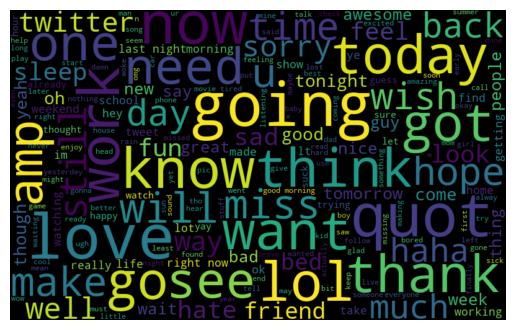

In [8]:
# Plot the Word Cloud
from wordcloud import WordCloud
allWord = ' '.join([twts for twts in df['text']])
wordCloud = WordCloud(width = 800, height = 500, random_state = 21, max_font_size=100).generate(allWord)

plt.imshow(wordCloud, interpolation = "bilinear")
plt.axis('off')
plt.show()

In [10]:
#Create a function to compute the negative, neutral and positive analysis

def getAnalysis(score):
    if score<0:
        return 'Negative'
    elif score==0:
        return 'Neutral'
    else:
        return 'Positive'

df['Analysis'] = df['Polarity'].apply(getAnalysis)


In [18]:
df.sample(5)

,target,ids,date,flag,user,text,Subjectivity,Polarity,Analysis
1287495,4,2002374015,Tue Jun 02 04:01:27 PDT 2009,NO_QUERY,Kia_whatever,aww.. the concert yesterday was really great....,0.800000,0.633333,Positive
877678,4,1685054821,Sat May 02 22:54:30 PDT 2009,NO_QUERY,natasha02,welcome to your new home *sends brownies*,0.677273,0.468182,Positive
274348,0,1990583550,Mon Jun 01 05:14:57 PDT 2009,NO_QUERY,dorkcore,why oh why did he not go to work today?! now i...,0.750000,-0.500000,Negative
1006908,4,1880654312,Fri May 22 02:01:01 PDT 2009,NO_QUERY,yagamidai,liked &quot;??? 1348 - ?? ???? ?????? ????? ?...,0.800000,0.600000,Positive
404211,0,2058369842,Sat Jun 06 14:48:13 PDT 2009,NO_QUERY,oh_jay_93,why does my sims 3 crash alllll the time,0.000000,0.000000,Neutral


In [20]:
# Print all of the positive tweets
j = 1

sortedDF = df.sort_values(by = ['Polarity'])
for i in range(0, sortedDF.shape[0]):
    if (sortedDF['Analysis'][i]=='Positive'):
        print(str(j)+ ')'+ sortedDF['text'][i])
        print()
        j= j+1

1)  - awww, that's a bummer.  you shoulda got david carr of third day to do it. ;d

2) i dived many times for the ball. managed to save 50%  the rest go out of bounds

3)my whole body feels itchy and like its on fire 

4) not the whole crew 

5) hey  long time no see! yes.. rains a bit ,only a bit  lol , i'm fine thanks , how's you ?

6) i would've been the first, but i didn't have a gun.    not really though, zac snyder's just a doucheclown.

7) ahh ive always wanted to see rent  love the soundtrack!!

8) i was out most of the day so didn't get much done 

9)ooooh.... lol  that leslie.... and ok i won't do it again so leslie won't  get mad again 

10)some1 hacked my account on aim  now i have to make a new one

11) awe i love you too!!!! 1 am here  i miss you

12)bed. class 8-12. work 12-3. gym 3-5 or 6. then class 6-10. another day that's gonna fly by. i miss my girlfriend 

13)really don't feel like getting up today... but got to study to for tomorrows practical exam... 

14) awww i

7071) here are some windows options  nothing free in this list though  i'll keep looking.

7072) waking up to an inbox filled with more stuff to do.

7073) that's very motivational but unfortunately i'm going to be stuck at a computer for most of the day 

7074)i should have went to this years iserlohn farewell party to get my huge traynor  (in team canada jersey) photo signed. am sulking now 

7075)im happy coz i just got twiiter and finally figured it out but im shattered that i have school tomorrow 

7076) are you in madrid now? omg! haha you are so tired  go to sleep and have fun in spain!

7077)1 more day! 

7078) good luck! i still wish the show was coming to scotland. 

7079)i really do feel it.. this is bogus.  

7080)wow losing a life on a basic enemy and not a boss is the ultimate shame 

7081) ds games hav no wifi but the browser has full bars i cant connect 2 p0k3m0nz 

7082)today's going to be beautiful again and my agenda is...work and study 

7083)another awesome weekend

19232) i need a new mobo/processor for mine. its already a year and a half old 

19233)my dear old munster not yr day  haven't caught any of the post match tittletattle yet.  roll on tipp vs cats!

19234)i miss my friends.  i miss them. really.

19235)k too busy in the studio to come home today 

19236)torres not in squad thanks to injury 

19237)feels like im getting no where with this...omg...i swear it will be more productive for me to bang my head against a brick wall  *cries*

19238)not too happy about flying with 106 confirmed cases of the swine flu in the u.s!! 

19239)oh no! i just realized i left my favorite swimsuit at the pool last thursday! 

19240)our mind sometimes see what our hearts wish were true 

19241)$tsys nice shakeout and support at the 50dma...although most recent quarter eps disappoints -9% 

19242) studying.. finals in 2 weeks.  but at least my boyfriend's coming over at 6.. so there's something good today too. ^^

19243)spent the afternoon with g. it was grea

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



162143) tweetcamp - what a great idea! shame it's so far away 

162144) are you serious?  hmm, that would a twist though since he's always wanted vamp blood, well now he got 'em! lol.

162145) awww man that's no fun cause that's just what i was gonna do 

162146) i'm on t-mobile, pretty good network. think i'm gonna give 2night a miss, am sat at my desk sipping a lemsip 

162147) no it wasn't that  ahh i want to remember the name so i can seek it out and play it and be happy that i'm now smarter! haha.

162148) hahah it was ok i got sent home becoz i am reali sik hha might have to go to hospital !  but yeha wat did you do at skul ?

162149) i'm at home had to come home last night  my babysitter not so easy like you lol

162150)_el  we'll have special solo feats

162151)woah. i'm listening to the ... radio. amazing what happens with no laptop 

162152)i am too old to stay til 1 am anymore. today is so gonna suck 

162153) you best be calling me boy! still haven't got mine yet  miss you 

174686)at the bath bike breakfast, not a huge turnout but free cakes, no bacon butties though 

174687)am very glad that the internet is back. it went away for a few hours. 

174688)sum1 tried too be smart and now i have to work..... 

174689)needs somewhere lovely for her birthday dinner - 25 people in central london, budget â£20pp + drinks. tierra brindisa too small 

174690)playing with tweetdeck. tis nice but wish i could find one twitter client that does everything i want harumph 

174691) yeah  all of them are busy and won't be able to make the show. i'm sorry.

174692)is ready to go home and sleep...i think i might have the flu again  anyone want to come mow my lawn today?

174693)okay okay. let me just say: i am happy for taylor swift, but super bummed that miranda lambert lost. my vote went to her. 

174694)isn't iphone 3.0 supposed to released today? itunes is still showing 2.2.1 as the latest 

174695) on the same note: i was sure 3.0 was to be released on the 16th so i wait

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



327042)on my way way to do 14 km on my fixed bike (thanks dad) and in the afternoon some running. shedding the pounds! 

327043).. hello everyone, thanx .. you're fun as always.,thnx i'm tailing you 

327044)ok. i'm having a heartattack. call 911 and tell them to meet me on the roof top of kress. make sure they're cute. 

327045) good morning 

327046) i like it way it is. just clean up the sides 

327047)follow    plz!  need him to get 60k so i can get a chance at having better luck in his and igor's next experiment 

327048)ok ... smallville finale tonight, gg and himym finales next week, and cb, robarney and clois are all going strong.  very nice. 

327049) happy birthday hun ! have a great one. enjoy your party ! i have friends attending that one 

327050) thanks laurie! i will tweet from my phone   have a great thursday!!

327051)new blost  

327052)_sp ok goodnight 

327053) it didnt hurt a lot when she did it, but it stung for a while afterwards. right now it doesnt hurt at all 

339775)right guys, off out to town, and cinema  ciao x

339776) go thru 'following' lists... oh and add  tells you which celebs on here are verified and real, not fake accts. 

339777) haha. true. it's a long story. i'm alright though. 

339778) yea that is really interesting congrats for it  5000 to more than 9000 in no time ur huge  xox

339779) nah ive seen it. just cant wait for it to be on tv  what shows you doing? im doing 14 shows. hahaha

339780) it really suits me lol  and i am so lookin forward to wed, so gonna be there  we can arrange our trip to america 

339781)going to earn some money i guess, so i can buy my tickets for holiday!  x going to get some new shoes too  x

339782) &quot;you can make $70, 000 a year talking about smurfs...&quot; man your cnn interview really crushed it! * brilliant! * 

339783)sold ï¿½140 worth of cake this morning! 

339784)  god loves a trier, or it that a man of faith? and i am special ;)

339785)_h_99 they're playing manchester on wednesday

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



541700) sure is better than the alternative 

541701) i am loving the gloomy day as well. the rain always makes me feel happy 

541702)mc mong!  radio is having really good songs 

541703)i love finding new hobbies &amp; creating art w/  &amp; jason.  this summer is definitely gonna be filled w/ music &amp; creativity! &lt;3it.

541704)welcome esther! 

541705) lmao!  not cute.  not cute at all.  but sailboat is fast becoming my fave twitterchar.  needs to make up some ground. 

541706)listened to kanye west and taylor swift a lot. found a place to live. didn't hang out with an ass. my days off were successful 

541707) good morning 

541708) take two of these   and you will feel better soon ;)

541709)yet another lovely day- hoping the weekend will be this nice 

541710)morning everyone - sun still shining, lovely 

541711) you more so than others! 

541712) hey!!!  glyph competition is great, everybody on my studies know that i'm freak about glyphs haha, i draw them everywhere

54171

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [15]:
# Print the negative tweets

j = 1
sortedDF = df.sort_values(by = ['Polarity'], ascending = False)
for i in range(0, sortedDF.shape[0]):
    if (sortedDF['Analysis'][i]=='Negative'):
        print(str(j)+ ')'+ sortedDF['text'][i])
        print()
        j= j+1

1) no, it's not behaving at all. i'm mad. why am i here? because i can't see you all over there. 

2)spring break in plain city... it's snowing 

3)i hate when i have to call and wake people up 

4)im sad now  miss.lilly

5)ok i'm sick and spent an hour sitting in the shower cause i was too sick to stand and held back the puke like a champ. bed now 

6) ill tell ya the story later  not a good day and ill be workin for like three more hours...

7) sorry! bed time came here (gmt+1)   

8) i don't either. its depressing. i don't think i even want to know about the kids in suitcases. 

9)sad, sad, sad. i don't know why but i hate this feeling  i wanna sleep and i still can't!

10)falling asleep. just heard about that tracy girl's body being found. how sad  my heart breaks for that family.

11)is strangely sad about lilo and samro breaking up. 

12) oh! i'm so sorry  i didn't think about that before retweeting.

13)broadband plan 'a massive broken promise'  via www.diigo.com/~tautao still w

9410)i already feel really bad about sad animals. please don't make me feel worse, sarah mclachlan. 

9411) lucky you! im at college today  i hate the class, iv got nothing to wear! arghhhh you ok? x

9412) i tried. and failed. 

9413)there's a creepy guy staring at me from the street...  im scared. hulk get mad. hulk smash!!! hulk turn into chuck norris....

9414) i watched a three hour movie on sex slavery on the hallmark channel. it was horrible 

9415)urgh, half an hour and its school timesssss. 

9416)   i'm sorry!!!  that totally sucks.

9417) please dont call yourself a celebrity  i dont want you to change &amp; get all big :/

9418)just put my replacement bezel on my 8900, and now i wish i would have bought the black instead of the silver! bummer 

9419)overdosed.  feeling like shit. afraid to sleep.

9420)y am i so effin sober?  wtf?!  i wanna see my boo!  

9421)i am a bad, bad person 

9422) yeah, work sucks huh? 

9423)_rogue what's wrong? 

9424) hahaha it will break my he

18287)has work in a few hours. 

18288) oh not fair. i've not even had a bacon sarnie yet 

18289) thought it was done but still a bit pink.... dammmnnnn back in 

18290) i get a peak speed of 512 kbps -- at peak times its worse than a dial-up 

18291)i am working on my presentation about czech national bank. no fun at all 

18292)im stucked in heavy pain on the way to home. 

18293)is super sad that today is my last day of leave 

18294)is not feeling well... tummy hurts... not used to sleeping this late  had fun with the girls today! tomorrow: parade of homes w/peter &lt;3

18295)_birch looking in the wrong place then 

18296)mad i'm awake!!! can't fall back 2 sleep 

18297)soooooo tired im going to bed now. i have to go to work in 5hrs 

18298)back at my mums. sundays are a useless day 

18299)is so bored  [phplurk.com] 

18300)[ clicks everyone unfollow button ] i'm sad; 

18301)writing assignment on differences between traditional market research &amp; user centered design. such a

26472)morning ... just noticed i seriously slept in today 

26473)i can't sleep because my ankle hurts so bad. 

26474)_burgess i'm not doing much better  i'm so sorry about last night, i just had such a horrible day, i couldnt face anyone. how was it?

26475)uh oh! my mouse is sick! 

26476)cat just brought me a small, struggling rodent which was flailing, but unable to get up. worst way to wake up in the middle of the night. 

26477) yep haha   but it's bad......  i have a caffeine addiction haha

26478) my grandfather was from michigan - i get confused with the fact that chicago is on lake michigan, gets me every time 

26479)&amp; now my kettle is broken.. . boiling kettle the old fashion wayyyy 

26480)  i wishh i could! i'm not a good sleeper @ night

26481) oh, too bad  well, better next time!

26482)back from rye  now skool tomz..gonna b a crap week :z

26483)&amp; now my kettle is broken.. . boiling water the old fashion wayyyy 

26484) i'm sorry hunny!!   i promise, once all 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



115120) it's so sad. 

115121)myspace is kind of stupid it wont let me reply 

115122) its a samsung pl50 i think its the hum of the motor but its very annoying 

115123) whats up? hate this weather ... 

115124)i'm sad... don't know what to do 

115125) -no &quot;real&quot; boyfriends, and no girlfriends. all of my relationships fail. 

115126)got home from english class. tons of homework to do this weekend. need to study as well  poor me.

115127) see,  i stopped watching bb, lifted some weights, got myself ready and u disappeared  too tired now. pass the cushion.

115128) what the hell my computer has randomly eaten half my 3eb collection 

115129)even though chrome doesn't support extensions, its worth it ! only this bug where my pointer stops clicking is damn annoying 

115130) it's such a tragic life. forced to work (with drugs and abuse) and then &quot;retired&quot; to a slaughterhouse for dog food. 

115131)just finished my geog final. my writing arm hurts and i'm beyond tired.

125148)no more liga futbol on the weekend  i guess wcq will do for now, uruguay-brazil &amp; argentina-colombia later 2day.

125149)is going out to get her nails painted! mocha marble cheesecake completed, but got slightly burnt due to defective oven 

125150)another huge storm flooded our garden, fucked with the flowers, &amp; made our stones all dirty. 

125151)i want to hear  's album so bad, but i got no monayyy! 

125152)god, i miss my books  dont worry loves, ill be home to pick you up soon -and then we can go for that vacation together &lt;3

125153)i've spent over â£100 in the itunes store in the past few months, that'll be why i'm skint 

125154)oh what a muddy mess. 

125155)is very confused planning all the meetup sessions for projectwork 

125156)fell asleep in bath. felt like a mermaid. tired   oh new phone in a few days 

125157)im really missing michigan..  cant wait to go home and see everyone!

125158) sometimes growing up is scary  , i ever felt that

125159)streaming

133237)i hate sunburn 

133238)my poor puppy won't top crying 

133239)bored cause mikki left . 

133240) call me.  seriously, i miss you 

133241) i know exactly what you mean 

133242)i think i only missed one person... because she left  well, if i missed you... sorry!

133243) i cant watch that right now.... internet is too slow... 

133244) no crockery smashing.  it actually ended up being quite boring &amp;  now a massive thunderstorm has woken me up after 3 hours sleep

133245)praying/hoping/ wishing for someone. i can't stand these lonely nights 

133246)listening to nickel creek and my friend luna crying through the wall 

133247)i can't believe birdie is gone.  what the eff?  sad. 

133248) i will be there as soon as i can after church tomorrow. do you have a truck? i'm sorry this has been such a horrific move 

133249)i think i'm coming down with the flu. not cool 

133250)i didn`t know that jay-z was called hov or hova.! but den aqain i could qive a darn about the biq lip fu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




219548)just had a play with a new iphone 3gs in the o2 store sadly had to give it back before leaving 

219549) it's going to be soooo hot for the kickball game today, and not just because i'll be playing. 2g1k

219550)unfortunately the lanyard does not have a silverstone ticket attached to it 

219551)back at the office, so wanted to lie down on the beach today 

219552)i am missing my iman ( even though i juz met her at the wedding) 

219553)come on regina, pick up your game, yeah?  this is made for prime time tv.

219554) too bad marissa can't play though.  

219555)packin up and gettin ready to leave pcb   sad day

219556) unless you b'day is at the end of the month, like me and everyone's sick of celebrating whenit's finally your turn 

219557)man, i want to be back at chapel hill with the entire school this time, i hated my ctops group, everyone was obnoxious 

219558) horrible  btw thank you

219559)i keep getting attacked by some stupid person with like 10 villages on travian 

229876)fuck you rock band 2 and your fucking up freezepop songs!! 

229877)don't you hate when u got two girls and the one you dont really want chooses u first!  lol..atleast their choosing tho i guess

229878)im wakey wakey wakey wakey got steak for lunch and cock with eyes lol.yay its sonday sonday sonday and tomorrow is fuck day 

229879)why am i so shy and awkward? 

229880)i just can't catch a break... i killed my foot today and now i'm limping around 

229881)and so hell week begins, andrew last morning leading and night preaching... then a farewell or final thing every day  moving is hard

229882)hears her bed sheets calling, but my body says too bad. 

229883)knockinqq // aimm lifeeeee .likee alwayss , damnn ii needdd ahh sidekick  [ ii knindaa feel like ah lame w| ouht one)          -lmaoo

229884) you bad ass (: get on aim. i missss chatting with you 

229885)hates life right now!  tired dont wanna work tomorrow! 

229886)i just had my grad party today!!! it was awsome!!! i d

240140) i've been reading that that's what you have to do.  too bad, i'll just have to wait it out 

240141) can't believe how painful it is. maybe it's just cos it's different to sqlserver, but right now it's hurting so bad 

240142) i understand, i've been divorced from my daughter's father about 15 years and still have to put up with his ridiculous behavior 

240143)feel like i'm gonna throw up again for the 10th time! don't know what's wrong with me this morning. cabbing it to my bed right now 

240144)anyone know of any jobs going, looks like i'll have been made redundant by the end of the month 

240145)swearing at my boss under my breath secretly wishing he could hear me 

240146) haha, you lucky bastard! we have a shirt and long pants dress code. that is awful right now 

240147)poor kitty   i admit it i shed some tears.  it hits so close to home.

240148)sighs~ run me over so i dont have to do the exam!!!  dont do serious damage though... just enough so i dont have to take the

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



294853) how 'bout &quot;shout, stop and drop&quot;.....you're turning this into a game for me here demi 

294854) my mother asked me last week what 'nhl' stood for, and i was honestly too shocked to answer. how am i related to these people? 

294855)ah. is bored. can i goes home now? ... feel like... sleeping! yes i shall sleep now. 

294856)baking cookies  and also my eyebrow keeps twitching... is that bad?

294857) totally legit question  and yes, i've been to a few (between me and my brother, we were total lotr nerds a while back)

294858) that's food for thought.... i'm so tired today but still wanna do those new things 

294859) i can't believe i failed.. they obviously failed me cos i'm too good at driving 

294860) it's way too much boring. have been breathing hard wd exhaustion 

294861) i'm in taiwan, probably not the farthest, or maybe i should say the southern part of taiwan to make it a little farther. 

294862) that just sucks! if you were in cpt i may have bought it from 

299100)joel mchale takes the stage at ubi presser...&quot;greetings fellow nerds!&quot; regrets having kids cause they interfere with game time.    htt ...

299101)_martyr i actually had the same meal minus the ramen noodles 

299102)_42 'masseuse' was the correct spelling. i always think it's wrong too 

299103)_02 thanks cat.  i am sick of looking at myself...maybe a twitter background change is what i need instead...one without moi on it 

299104) that's serious. 

299105)just an update for all my women followers: i'm still single 

299106)aaaaw its the brad pitt episode on friends!!!!! omg i want to hump this man soooooo bad 

299107)it's time for a 3 martini lunch with the mad men (and sushi on the way). this is how we role, when we are over worked. 

299108) looks like i might in a contender in the 'crap day' stakes, hasn't started too well so far! hope yours is better 

299109) aw come on, don't spread the bad karma.  she'll get hers... eventually.  she's probably just jealous. 

302646) - oh, i cannot forget about sammy !  yikes! don't mess with him 

302647) yup!  bald tires replaced with fresh (used) tires.    mount rushmore in a few hours!! can i bring anything back for you?

302648)i hate going to school  it makes me angry  oh well i  only have to go to 6 more days of school 

302649)trying to fix the mess i created when i uploaded a new background!  

302650) uh oh. someone is in trouble. going to the principle's office. 

302651)is sawing down the wonky tree in her garden &amp; what glorious sunshine for the task... 

302652)time's been going so fast lately! i mean, it feels like it should be january but it's already june  november feels like yesterday (l)

302653)time for bed... got two and half pages written. it's not much, but hey, it's something. 

302654)goodmorning twitter !! it's cold in argentina 

302655)just finished a video with amber. we were like super crazy!we had nothing else to do so we videod our crazy selves. uploading.. 

302656) --- y

306933) thx twibff.  i dont know what im going to do when i go back to school n the fall. i been out for a yr and a half. s*d* ...

306934) go yanks! and bring a poncho...rain for the next few days. 

306935)....hmmmm... taking my dinner w/ my little cousins ... 

306936) 'the louder one talks, the less they are likely to listen'. you know what? tweets are to short to have adebate anyway 

306937) we will be there saturday!  little zingerman's before the show   can't wait!

306938)oooooo bigbrother 10 bb10 starts tomorrow its so wrong but im looking forward to it  another summer of bb  ht... 

306939)_dsm just finished watching dirty sexy money...all 19 episodes 

306940)ughh i won't everr get bored sayn this...tha i jus wanna go home!! no school in a week! can't wait!!! 

306941)yess i done all my work and i so tired but is over 

306942) well depends...... i usually do come onlyn even when she's near by.... 

306943)tjohoo! am voting today! don't know for who yet, but at least i'm vo

311492)haha, it was raining today.  sucks for the graduation!  

311493) those that r here r the shit! your on vacation... vacate!        angie

311494)morning  sims 3 time after i've had my breakfast i think i'll have egg on toast :-/ 

311495) oh boo 2 late in bed now.  &amp; i could've told u all about the date that i went on tonight.  &amp; i prefer 2 drink above the table

311496) fancy having a whip round to see if we can buy liverpool? new away shirt should be delivered on monday 

311497) spider monkey!!!!!! ps pickle = the hulks penis js 

311498)try this phot-3d-mapped, anim-face  make your mouse go crazy!  via engadget 

311499) u never said where i wee until it was too late  r we doing dinner with tomoe on sunday?

311500) hi sweetheart!  i'm finally getting on here after a long day! feww! =d i just read all your twits.  and i interpreted

311501)its past 3 in the morning!!!  and i'm finally done fixing my ipod...   night night

311502)realized about 2 hours ago, she ain't 

316048)got the last 4 books of the left behind the kid's series today. excited to finally get to the end of the story and see how it turns out. 

316049)&quot;work&quot; is a four-letter word. at least it pays for the wow  

316050) way to bring up my dog...my dog that died when i was 14. worst day of my life i think. (i've had it pretty easy with deaths 

316051)dance the dandy down sistas // _brightside _devine  - dance?  â« 

316052)just sittin here rly bored at the rec department 

316053) ironically i am watching the end of the dodgers game waiting for the world cup qualifier to begin, i might note. 

316054) re: your pic u just posted..... i dont think ill ever get tired of you  heheh

316055)hehehe drunkenness  good crack  never going to try singing dream catch me by newton faulkner again though! screwed it up :'(

316056)@ the game wit  and paula  !! 

316057)  we can have shots of whiskey, vodka, or the blue cocktail or bloody mary cocktail xd

316058)had a huge session on wa

321041)_eire yeah, hair down to my arse. really was called jesus once, or at least people said &quot;jesus christ&quot; when they saw me 

321042)had a mad fun yesterday  sooo tired going out soon!

321043) i missed ya but i was tired 

321044)somebody crazy let daniel and me do kids worship this morning!! happy to report everyone survived with only minor injuries 

321045)the 1st person to come to the broadway across america booth at 9th and long and say &quot;puttin on the ritz&quot; gets a surprise!!  fb

321046)  crossing my fingers  -- i have even built a blog which i am not sure if i'll ever use:  

321047) *afternoon ass bite* hiya... getting your mad ninja skills out again... 

321048) mmmmmmm, save a few and make cherry yogurt smoothies tonight for dessert. 

321049) i know. but whatever.  i know you mean me. ^^

321050) i bet your a bit tired of talking about star trek 

321051) i would give you the ones from last night but my bag got wet someone spilled something . i can giv

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
# Plot the polarity and subjectivity

plt.figure(figsize=(8,6))
for i in range(0, df.shape[0]):
    plt.scatter(df['Polarity'][i], df['Subjectivity'][i], color='Blue')
    
plt.title('Sentimental Analysis')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')
plt.show()


In [22]:
# Get the percentage of the positive tweets
ptweets = df[df.Analysis=='Positive']
ptweets = ptweets['text']

round((ptweets.shape[0]/df.shape[0])*100, 1)

43.6

In [24]:
# Get the percentage of the Negative tweets
ntweets = df[df.Analysis=='Negative']
ntweets = ntweets['text']

round((ntweets.shape[0]/df.shape[0])*100, 1)

20.8

In [27]:
# Show the value Count

df['Analysis'].value_count()

#plot and visualize the count
plt.title('Sentimental Analysis')
plt.xlabel('Sentiment')
plt.ylabel('Counts')
df['Analysis'].value_count().plot(kind='bar')
plt.show()


AttributeError: 'Series' object has no attribute 'values_count'